#SSN - Earthquekes
****
Jonathan Adrian Rosales Herrera - 22/09/2023

In-depth analysis of seismic data from the National Seismological System of the National Autonomous University of Mexico (UNAM). Leveraging the extensive historical dataset of earthquakes in Mexico, this project aims to uncover patterns, trends, and insights crucial for understanding seismic activity in the region.

##Kaggle

In [ ]:
from google.colab import files
files.upload() # Upload Kaggle's API

In [ ]:
!ls -lha kaggle.json # print
!pip install -q kaggle # installing the kaggle package
!mkdir -p ~/.kaggle # creating .kaggle folder where the key should be placed
!cp kaggle.json ~/.kaggle/ # move the key to the folder
!pwd # checking the present working directory
!chmod 600 ~/.kaggle/kaggle.json # Change file mode bits

-rw-r--r-- 1 root root 63 Sep 23 03:27 kaggle.json
/content


In [ ]:
!kaggle datasets download -d johnr0s/ssn-unam-sismos-1925-2023

100% 6.84M/6.84M [00:00<00:00, 13.1MB/s]
100% 6.84M/6.84M [00:00<00:00, 9.35MB/s]


In [ ]:
!unzip /content/ssn-unam-sismos-1925-2023.zip

Archive:  /content/ssn-unam-sismos-1925-2023.zip
  inflating: SSNMX_catalogo_19230101_20230922.csv  


##Importing Libraries

In [ ]:
import pandas as pd
import plotly.express as px
import seaborn as sns

##Reading CSV

In [ ]:
df = pd.read_csv('/content/SSNMX_catalogo_19230101_20230922.csv')

<ipython-input-135-2cd9480e6110>:1: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



In [ ]:
df

,Fecha UTC,Hora UTC,Magnitud,Latitud,Longitud,Profundidad,Referencia de localizacion,Fecha local,Hora local,Estatus
0,07/08/1925,07:47:48,6.7,19.00,-102.00,100,"10 km al SURESTE de NUEVA ITALIA, MICH",07/08/1925,01:47:48,revisado
1,16/11/1925,11:54:54,7,18.00,-107.00,33,"291 km al SUROESTE de CIHUATLAN, JAL",16/11/1925,05:54:54,revisado
2,10/12/1925,14:14:42,7,15.50,-92.50,33,"31 km al NOROESTE de MOTOZINTLA, CHIS",10/12/1925,08:14:42,revisado
3,10/02/1928,04:39:37,6.5,18.26,-97.99,84,"9 km al NORESTE de ACATLAN DE OSORIO, PUE",09/02/1928,22:39:37,revisado
4,22/03/1928,04:17:30,7.5,15.67,-96.10,33,"12 km al SURESTE de CRUCECITA, OAX",21/03/1928,22:17:30,revisado
...,...,...,...,...,...,...,...,...,...,...
288201,22/09/2023,08:38:19,3.1,19.37,-103.75,29.5,"12 km al NORTE de VILLA DE ALVAREZ, COL",22/09/2023,02:38:19,verificado
288202,22/09/2023,10:18:24,3.6,18.69,-103.86,4.3,"24 km al SUR de TECOMAN, COL",22/09/2023,04:18:24,verificado
288203,22/09/2023,10:22:49,3.6,30.95,-116.51,7.3,"56 km al NOROESTE de VICENTE GUERRERO, BC",22/09/2023,04:22:49,verificado
288204,22/09/2023,10:50:17,4.0,15.03,-94.23,28.7,"127 km al SUROESTE de TONALA, CHIS",22/09/2023,04:50:17,verificado


##Preliminary Data Analysis

In [ ]:
df.shape

(288206, 10)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288206 entries, 0 to 288205
Data columns (total 10 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   Fecha UTC                   288206 non-null  object 
 1   Hora UTC                    288206 non-null  object 
 2   Magnitud                    288206 non-null  object 
 3   Latitud                     288206 non-null  float64
 4   Longitud                    288206 non-null  float64
 5   Profundidad                 288206 non-null  object 
 6   Referencia de localizacion  288206 non-null  object 
 7   Fecha local                 288206 non-null  object 
 8   Hora local                  288206 non-null  object 
 9   Estatus                     288206 non-null  object 
dtypes: float64(2), object(8)
memory usage: 22.0+ MB


In [ ]:
df.nunique()

Fecha UTC                     16845
Hora UTC                      83161
Magnitud                        134
Latitud                       50357
Longitud                      56143
Profundidad                    2210
Referencia de localizacion    40907
Fecha local                   16834
Hora local                    83116
Estatus                           2
dtype: int64

In [ ]:
df.isna().sum()

Fecha UTC                     0
Hora UTC                      0
Magnitud                      0
Latitud                       0
Longitud                      0
Profundidad                   0
Referencia de localizacion    0
Fecha local                   0
Hora local                    0
Estatus                       0
dtype: int64

Heatmap null data

<Axes: >

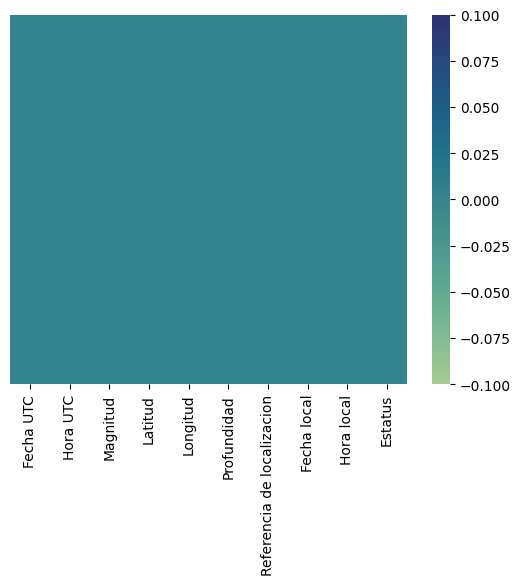

In [ ]:
sns.heatmap(df.isnull(), yticklabels=False, cmap="crest")

In [ ]:
df.corr()

<ipython-input-114-2f6f6606aa2c>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,Latitud,Longitud
Latitud,1.000000,-0.903533
Longitud,-0.903533,1.000000


In [ ]:
df.Magnitud.value_counts()

3.6              21027
3.5              20014
3.7              19940
no calculable    17649
3.8              17087
                 ...  
7.1                  1
8.1                  1
7.4                  1
7.9                  1
0.8                  1
Name: Magnitud, Length: 134, dtype: int64

In [ ]:
df[df['Magnitud'] == 'no calculable']

,Fecha UTC,Hora UTC,Magnitud,Latitud,Longitud,Profundidad,Referencia de localizacion,Fecha local,Hora local,Estatus
97,10/01/1974,14:35:40,no calculable,17.5800,-103.1100,33,"97 km al SUROESTE de LA MIRA, MICH",10/01/1974,08:35:40,revisado
99,15/01/1974,02:29:53,no calculable,17.9200,-94.6700,33,"7 km al SURESTE de JALTIPAN DE MORELOS, VER",14/01/1974,20:29:53,revisado
101,19/01/1974,16:32:49,no calculable,15.5500,-94.0800,33,"69 km al SUROESTE de TONALA, CHIS",19/01/1974,10:32:49,revisado
103,21/01/1974,07:54:01,no calculable,17.8000,-94.9000,33,"11 km al SURESTE de SAYULA DE ALEMAN, VER",21/01/1974,01:54:01,revisado
105,22/01/1974,22:39:15,no calculable,15.4100,-94.6400,33,"104 km al SURESTE de SALINA CRUZ, OAX",22/01/1974,16:39:15,revisado
...,...,...,...,...,...,...,...,...,...,...
32227,04/07/2001,16:23:50,no calculable,28.7400,-111.0400,10,"41 km al SUR de HERMOSILLO, SON",04/07/2001,11:23:50,revisado
32283,24/07/2001,05:39:57,no calculable,26.0400,-110.4300,10,"91 km al ESTE de LORETO, BCS",24/07/2001,00:39:57,revisado
57909,07/11/2012,05:13:54,no calculable,14.1545,-92.3360,41.8,"61 km al SUROESTE de CD HIDALGO, CHIS",06/11/2012,23:13:54,revisado
70868,20/11/2014,14:45:25,no calculable,18.3343,-103.3340,20,"52 km al SUROESTE de COALCOMAN, MICH",20/11/2014,08:45:25,revisado


In [ ]:
df.Profundidad

0          100
1           33
2           33
3           84
4           33
          ... 
288201    29.5
288202     4.3
288203     7.3
288204    28.7
288205     7.7
Name: Profundidad, Length: 288206, dtype: object

In [ ]:
df[df['Profundidad'] == 'en revision']

,Fecha UTC,Hora UTC,Magnitud,Latitud,Longitud,Profundidad,Referencia de localizacion,Fecha local,Hora local,Estatus
56170,29/06/2012,16:40:01,4.2,13.5565,-92.1658,en revision,"124 km al SUR de CD HIDALGO, CHIS",29/06/2012,11:40:01,revisado
58912,10/01/2013,02:08:18,3.5,16.3752,-98.4303,en revision,"34 km al SUR de OMETEPEC, GRO",09/01/2013,20:08:18,revisado
59094,25/01/2013,01:43:29,3.6,16.3760,-97.8715,en revision,"20 km al ESTE de PINOTEPA NACIONAL, OAX",24/01/2013,19:43:29,revisado
59651,07/03/2013,15:14:51,3.4,16.2555,-98.3822,en revision,"37 km al SUROESTE de PINOTEPA NACIONAL, OAX",07/03/2013,09:14:51,revisado
61996,26/08/2013,06:14:51,3.9,16.9867,-100.0370,en revision,"6 km al SURESTE de COYUCA DE BENITEZ, GRO",26/08/2013,01:14:51,revisado
65892,18/04/2014,23:07:34,3.4,17.2105,-100.9970,en revision,"39 km al OESTE de TECPAN, GRO",18/04/2014,18:07:34,revisado
67102,18/06/2014,12:16:35,2.7,15.1815,-91.9662,en revision,"30 km al NORESTE de CACAHOATAN, CHIS",18/06/2014,07:16:35,revisado
70051,12/10/2014,14:19:33,3.4,18.1200,-103.4230,en revision,"78 km al SUROESTE de COALCOMAN, MICH",12/10/2014,09:19:33,revisado
72255,19/01/2015,19:12:36,3.8,31.2120,-114.7660,en revision,"22 km al NORESTE de SAN FELIPE, BC",19/01/2015,13:12:36,revisado
73925,15/03/2015,16:57:37,4,13.6932,-92.9562,en revision,"139 km al SUROESTE de CD HIDALGO, CHIS",15/03/2015,10:57:37,revisado


In [ ]:
df[df['Profundidad'] == 'menos de 1']

,Fecha UTC,Hora UTC,Magnitud,Latitud,Longitud,Profundidad,Referencia de localizacion,Fecha local,Hora local,Estatus
169826,12/07/2019,09:47:41,2.0,19.4077,-99.1950,menos de 1,"menos de 1 km al NOROESTE de MIGUEL HIDALGO, CDMX",12/07/2019,04:47:41,revisado
169836,12/07/2019,12:38:28,2.7,19.4049,-99.1959,menos de 1,"1 km al SUROESTE de MIGUEL HIDALGO, CDMX",12/07/2019,07:38:28,revisado
169841,12/07/2019,15:08:04,2.4,19.4049,-99.1939,menos de 1,"menos de 1 km al SUROESTE de MIGUEL HIDALGO, CDMX",12/07/2019,10:08:04,revisado
169882,13/07/2019,06:35:36,2.4,19.4075,-99.1952,menos de 1,"menos de 1 km al OESTE de MIGUEL HIDALGO, CDMX",13/07/2019,01:35:36,revisado
169916,13/07/2019,16:39:20,2.4,19.3920,-99.2173,menos de 1,"2 km al SUROESTE de V ALVARO OBREGON, CDMX",13/07/2019,11:39:20,revisado
170134,17/07/2019,04:10:52,2.6,19.4028,-99.2102,menos de 1,"1 km al NOROESTE de V ALVARO OBREGON, CDMX",16/07/2019,23:10:52,revisado
170135,17/07/2019,04:18:46,2.4,19.4019,-99.2138,menos de 1,"1 km al OESTE de V ALVARO OBREGON, CDMX",16/07/2019,23:18:46,revisado
170144,17/07/2019,05:41:36,2.4,19.3983,-99.2173,menos de 1,"2 km al OESTE de V ALVARO OBREGON, CDMX",17/07/2019,00:41:36,revisado
170146,17/07/2019,05:45:53,2.4,19.4010,-99.2130,menos de 1,"1 km al OESTE de V ALVARO OBREGON, CDMX",17/07/2019,00:45:53,revisado
170149,17/07/2019,06:04:24,2.4,19.3980,-99.2158,menos de 1,"2 km al OESTE de V ALVARO OBREGON, CDMX",17/07/2019,01:04:24,revisado


In [ ]:
df.Estatus.value_counts()

revisado      276988
verificado     11218
Name: Estatus, dtype: int64

In [ ]:
df.columns

Index(['Fecha UTC', 'Hora UTC', 'Magnitud', 'Latitud', 'Longitud',
       'Profundidad', 'Referencia de localizacion', 'Fecha local',
       'Hora local', 'Estatus'],
      dtype='object')

##Cleaning Data

Changing column names to lowercase and replacing spaces with underscores

In [ ]:
df.columns = df.columns.str.lower().str.replace(' ', '_')

Replacing strings in *magnitud* and *profundidad* with 0.5 (*menos de 1*) and mean

In [ ]:
df['profundidad'] = df['profundidad'].replace('menos de 1', '0.5')

In [ ]:
mean_mag = df[df['magnitud'] != 'no calculable']['magnitud'].astype(float).mean()
mean_pro = df[df['profundidad'] != 'en revision']['profundidad'].astype(float).mean()

In [ ]:
df['magnitud'] = df['magnitud'].replace('no calculable', mean_mag).astype(float)
df['profundidad'] = df['profundidad'].replace('en revision', mean_pro).astype(float)

In [ ]:
del mean_mag, mean_pro

## Transforming Data

Changing data type to datetime

In [ ]:
df['fecha_utc'] = pd.to_datetime(df['fecha_utc'], format='%d/%m/%Y')
df['fecha_local'] = pd.to_datetime(df['fecha_local'], format='%d/%m/%Y')

In [ ]:
df['hora_utc'] = pd.to_datetime(df['hora_utc'], format='%H:%M:%S')
df['hora_local'] = pd.to_datetime(df['hora_local'], format='%H:%M:%S')

Maping and replacing on *estatus*

In [ ]:
map = {'revisado': 0, 'verificado': 1}

In [ ]:
df['estatus'] = df['estatus'].replace(map)

In [ ]:
del map

Getting the state

In [ ]:
def ab_state(record):
    abbreviation_state = {
        'AGS': 'Aguascalientes',
        'BC': 'Baja California',
        'BCS': 'Baja California Sur',
        'CAM': 'Campeche',
        'COAH': 'Coahuila',
        'COL': 'Colima',
        'CHIS': 'Chiapas',
        'CHIH': 'Chihuahua',
        'CDMX': 'Ciudad de México',
        'DGO': 'Durango',
        'GTO': 'Guanajuato',
        'GRO': 'Guerrero',
        'HGO': 'Hidalgo',
        'JAL': 'Jalisco',
        'MEX': 'México',
        'MICH': 'Michoacán',
        'MOR': 'Morelos',
        'NAY': 'Nayarit',
        'NL': 'Nuevo León',
        'OAX': 'Oaxaca',
        'PUE': 'Puebla',
        'QRO': 'Querétaro',
        'QROO': 'Quintana Roo',
        'SIN': 'Sinaloa',
        'SLP': 'San Luis Potosí',
        'SON': 'Sonora',
        'TAB': 'Tabasco',
        'TAMPS': 'Tamaulipas',
        'TLAX': 'Tlaxcala',
        'VER': 'Veracruz',
        'YUC': 'Yucatán',
        'ZAC': 'Zacatecas'
    }

    words = record.split()
    for word in words:
        if word in abbreviation_state:
            return abbreviation_state[word]
    return 'No encontrado'


In [ ]:
df['estado'] = df['referencia_de_localizacion'].apply(ab_state)

Removing columns

In [ ]:
ls_drop = ['fecha_local','hora_local', 'referencia_de_localizacion']

In [ ]:
df.drop(ls_drop, axis=1, inplace=True)

In [ ]:
del ls_drop

## EDA (Data Visualizations)

In [ ]:
corr = df.corr()
fig = px.imshow(corr, x=corr.columns, y=corr.columns, color_continuous_scale='Viridis', title="Correlation Matrix")
fig.show()

<ipython-input-151-9e6f8a9a1abe>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



In [ ]:
fig = px.histogram(df, x=df.magnitud,  title='Histogram of Magnitude')
fig.show()

In [ ]:
fig = px.histogram(df, x=df.profundidad,  title='Histogram of Depth')
fig.show()

In [ ]:
fig = px.histogram(df, x='estado', title='Earthquakes by State')
fig.update_xaxes(categoryorder='total descending')
fig.show()

In [ ]:
fig = px.histogram(df, x=df['fecha_utc'].dt.month, title='Earthquakes by Month')
fig.update_layout(bargap=0.1)
fig.update_xaxes(categoryorder='total ascending')
fig.update_xaxes(tickvals=list(range(1, 13)), ticktext=['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])
fig.show()

In [ ]:
fig = px.histogram(df, x=df['hora_utc'].dt.hour, title='Earthquakes by Hour')
fig.update_layout(bargap=0.1)
fig.update_xaxes(categoryorder='total ascending')
fig.update_xaxes(tickvals=list(range(0, 25)))
fig.show()

In [ ]:
fig = px.scatter(df, x='profundidad', y='magnitud', title='Scatter Plot: Magnitude vs. Depth')
fig.update_xaxes(title='Depth')
fig.update_yaxes(title='Magnitude')
fig.show()

In [ ]:
fig = px.density_mapbox(df, lat='latitud', lon='longitud', title='Heatmap: Geographic Distribution',
                        center={'lat': 19.4326, 'lon': -99.1332}, zoom=4,
                        range_color=(0, df['latitud'].max()), labels={'latitud': 'Latitude', 'longitud': 'Longitude'})
fig.update_layout(mapbox_style="stamen-terrain")
fig.show()

In [ ]:
fig = px.line(df, x='fecha_utc', y='magnitud', title='Time Series: Earthquake Magnitude')
fig.show()

## Insights

Based on this analysis, we gain valuable insights into the characteristics and underlying trends within seismic activity in Mexico.


1. **Magnitude Distribution**: The histogram of earthquake magnitudes shows that the majority of earthquakes in Mexico fall within a Normal Distribution with the highest value being 3.6 on the Richter scale.
2. **Depth Distribution**: We observe a left-skewed distribution, indicating that earthquakes generally do not tend to occur (at least those recorded) at depths greater than 150 km, and those extending beyond up to 300 km are usually less frequent.
3. **State**: We also observe the state with the most recorded earthquakes is Oaxaca doubling the records of the next one.
4. **Month**: Coinciding with the popular belief that has spread in recent years in Mexico, earthquakes tend to occur more frequently in the month of September.
5. **Hour**: Unexpectedly, we can also observe a left-skewed bell-shaped distribution (morning hours) regarding the occurrence time of seismic events.
6. **Magnitude vs Depth**: The correlation between these two variables is strong pointing the fact that the most of the earthquakes recorded happend not so deep.
7. **Heatmap**: We can obtain a clearer visualization of the region where the majority of events occurred, aligning with the findings from the state histogram.


These insights provide a glimpse into the nature and tendencies of earthquakes in Mexico. Further in-depth analysis and research can help refine our understanding of seismic activity in the region and contribute to better earthquake preparedness and risk assessment.